In [1]:
import requests
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import mplcyberpunk

content_key = 'V8WNFQD9V3XSWOUBG55HYIOFVSIJUNCL'

In [2]:
tickers = ['SOXL', 'TQQQ']

date = []
close = []

for ticker in tickers:
    endpoint = r"https://api.tdameritrade.com/v1/marketdata/{}/pricehistory".format(ticker)
    payload = {'apikey':content_key,
                'periodType':'year',
                'period': 10,
                'frequency':'1',
                'frequencyType':'daily',
                }
    content = requests.get(url = endpoint, params = payload)
    stock_data = content.json()
    prices = []
    for d in stock_data['candles']:
        prices.append(d)
    df = pd.DataFrame(prices)
    df['datetime']=pd.to_datetime(df['datetime']/1000, unit='s')
    date = df['datetime']
    close.append(df['close'])

for x in range(len(close)):
    close[x]/=close[x][0]

mean = close[0]
for a in range(len(close)-1):
    mean = [x+y for x,y in zip(mean,close[a+1])]
mean = [x/len(close) for x in mean]

C:\Users\Jason_yj4bjfp\AppData\Local\Temp\ipykernel_21284\1383706381.py:2: MatplotlibDeprecationWarning: The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.
  plt.style.use('seaborn-bright')


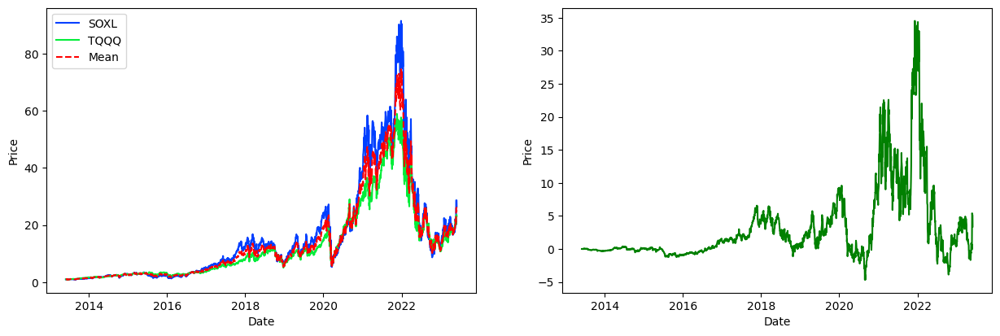

In [3]:
plt.figure(figsize=(15, 10), dpi=100)
plt.style.use('seaborn-bright')
plt.subplot(2, 2, 1)
for x in range(len(close)):
    plt.plot(date, close[x], label = tickers[x])
plt.plot(date, mean, 'r--', label = 'Mean')
plt.xlabel('Date')
plt.ylabel('Price')
plt.legend()

diff = close[0]-close[1]
plt.subplot(2, 2, 2)
plt.plot(date, diff, 'g-')
plt.xlabel('Date')
plt.ylabel('Price')

plt.show()

In [4]:
nasdaq100_tickers = [
    "AAPL", "AMAT", "AMGN", "AMZN", "ATVI", "AVGO", "BIDU", "BIIB", "BKNG", "BMRN",
    "CDW","CHKP", "CMCSA", "COST", "CSCO", "CSX", "CTAS", "CTSH", "DLTR",
    "EA", "EBAY", "EXC", "FAST", "META", "FISV", "FOXA", "GILD", "GOOG",
    "IDXX", "ILMN", "INCY", "INTC", "INTU", "ISRG", "JD", "KDP", "KHC",
    "KLAC", "LRCX", "LULU", "MAR", "MCHP", "MDLZ", "MELI", "MNST", "MRNA", "MRVL",
    "MSFT", "MTCH", "MU", "NFLX", "NTES", "NVDA", "NXPI", "OKTA", "ORLY",
    "PAYX", "PCAR", "PDD", "PEP", "PTON", "PYPL", "QCOM", "REGN", "ROST", "SBUX",
    "SGEN", "SIRI", "SNPS", "SPLK", "SWKS", "TCOM", "TEAM", "TMUS", "TSLA", "TXN",
    "VRSK", "VRSN", "VRTX", "WBA", "WDAY", "XEL", "ZM"
]
close = []

for ticker in nasdaq100_tickers:
    endpoint = r"https://api.tdameritrade.com/v1/marketdata/{}/pricehistory".format(ticker)
    payload = {'apikey':content_key,
                'periodType':'year',
                'period': 5,
                'frequency':'1',
                'frequencyType':'daily',
                }
    content = requests.get(url = endpoint, params = payload)
    stock_data = content.json()
    prices = []
    for d in stock_data['candles']:
        prices.append(d)
    df = pd.DataFrame(prices)
    close.append(df['close']/df['close'][0])

data = pd.concat(
    close,
    axis=1,
    keys=nasdaq100_tickers
)

In [5]:
plt.figure(figsize=(40, 40), dpi=400)
corr_matrix = data.corr()
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', vmin=-1, vmax=1)
plt.title('Correlation Matrix')
plt.show()

(array([ 16.,  28.,  53.,  70.,  97., 121., 192., 187., 130., 136., 129.,
        168., 206., 253., 288., 381., 337., 371., 240.]),
 array([-0.77825696, -0.68567195, -0.59308694, -0.50050193, -0.40791692,
        -0.31533192, -0.22274691, -0.1301619 , -0.03757689,  0.05500812,
         0.14759312,  0.24017813,  0.33276314,  0.42534815,  0.51793316,
         0.61051816,  0.70310317,  0.79568818,  0.88827319,  0.9808582 ]),
 <BarContainer object of 19 artists>)

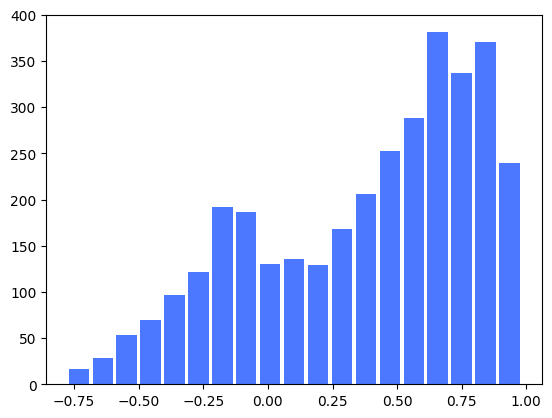

In [6]:
corrs = []
counter = 0
for x in range(len(corr_matrix)):
    for y in range(x,len(corr_matrix)):
        if corr_matrix.iloc[x,y] < 1 and corr_matrix.iloc[x,y] < 1.0:
            corrs.append(corr_matrix.iloc[x,y])
plt.hist(corrs, bins='auto', alpha=0.7, rwidth=0.85)

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or R

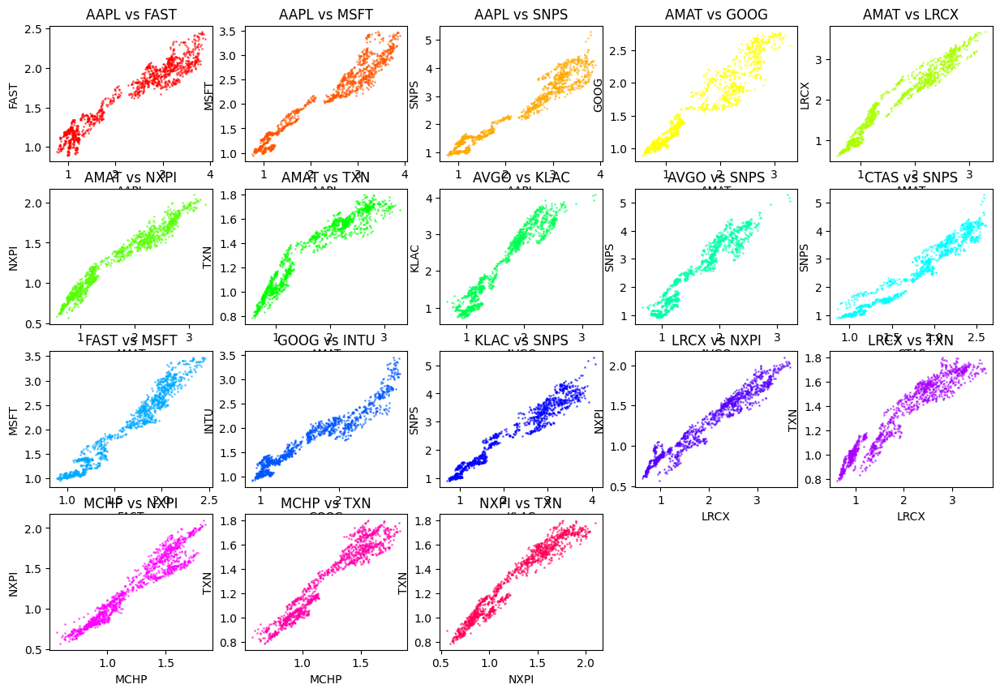

In [7]:
import matplotlib.colors as mcolors
plt.figure(figsize=(15, 10), dpi=100)
keys = corr_matrix.keys()
hashmap = {}

counter = 1
m=18
colors = [mcolors.hsv_to_rgb((i / m, 1, 1)) for i in range(m)]

for x in keys:
    for y in keys:
        if corr_matrix.loc[x,y] > 0.96 and x != y and y not in hashmap:
            plt.subplot(4,5,counter)
            counter+=1
            plt.scatter(data[x], data[y], s=1, c=colors[counter-2], alpha=0.5)
            plt.title(x + ' vs ' + y)
            plt.xlabel(x)
            plt.ylabel(y)
            hashmap[x] = y

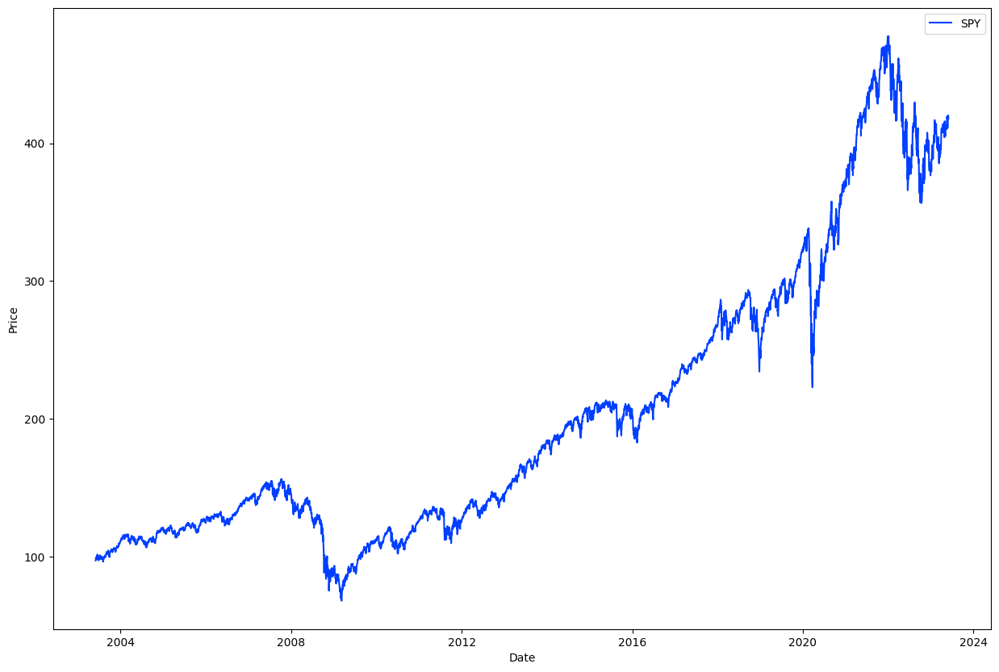

In [113]:
tickers = ['SPY']

date = []
close = []

for ticker in tickers:
    endpoint = r"https://api.tdameritrade.com/v1/marketdata/{}/pricehistory".format(ticker)
    payload = {'apikey':content_key,
                'periodType':'year',
                'period': 20,
                'frequency':'1',
                'frequencyType':'daily',
                }
    content = requests.get(url = endpoint, params = payload)
    stock_data = content.json()
    prices = []
    for d in stock_data['candles']:
        prices.append(d)
    df = pd.DataFrame(prices)
    df['datetime']=pd.to_datetime(df['datetime']/1000, unit='s')
    date = df['datetime']
    close.append(df['close'])
plt.figure(figsize=(15, 10), dpi=100)
plt.plot(date, close[0], label = tickers[0])
plt.xlabel('Date')
plt.ylabel('Price')
plt.legend()

C:\Users\Jason_yj4bjfp\AppData\Local\Temp\ipykernel_21284\3189078823.py:3: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  y = close[-len(close):]


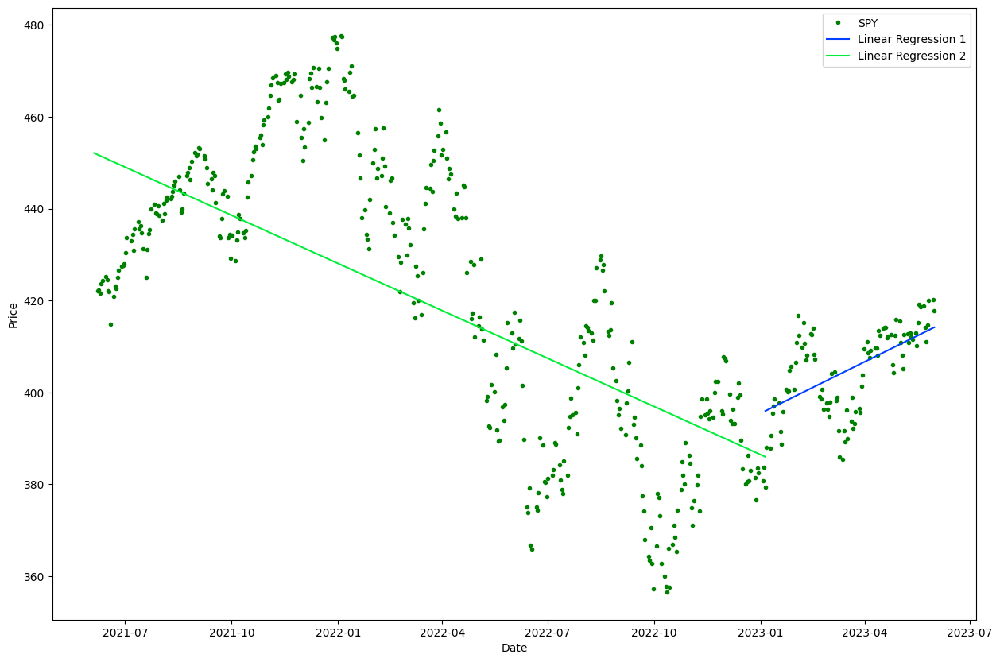

In [114]:
def linreg(close):
    X = np.linspace(0, len(close)-1, len(close))
    y = close[-len(close):]
    X_b = np.c_[np.ones((len(X),1)), X]
    theta_min = np.linalg.inv(X_b.T.dot(X_b)).dot(X_b.T).dot(y)
    X_new = np.array([[0], [len(close)-1]])
    X_new_b = np.c_[np.ones((2,1)), X_new]
    y_predict = X_new_b.dot(theta_min)
    return y_predict

len_1 = 100
len_2 = 400

date_reg_1 = [date[len(date)-1-len_1], date[len(date)-1]]
date_reg_2 = [date[len(date)-1-len_2-len_1], date[len(date)-1-len_1]]

plt.figure(figsize=(15, 10), dpi=100)
plt.plot(date[-len_1-len_2:], close[0][-len_1-len_2:], 'g.', label = tickers[0])
plt.plot(date_reg_1, linreg(close[0][-len_1:]), label = 'Linear Regression 1', )
plt.plot(date_reg_2, linreg(close[0][-len_2-len_1:]), label = 'Linear Regression 2', )
plt.xlabel('Date')
plt.ylabel('Price')
plt.legend()

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import numpy as np
import matplotlib as mpl
mpl.rc('animation', html='jshtml')
plt.rcParams['animation.embed_limit'] = 200

# Sliding window stock strategy

def sliding_window(len_1=100, len_2=500, frames=4000):
    fig, ax = plt.subplots(figsize=(10, 6), dpi=70)
    X = date[len(date)-1-len_1-len_2-frames:len(date)-1-frames]
    y = close[0][len(date)-1-len_1-len_2-frames:len(date)-1-frames]
    line, = ax.plot(X, y, 'g.', label="Ticker")
    date_reg_1 = [date[len(date)-1-len_1-frames], date[len(date)-1-frames]]
    date_reg_2 = [date[len(date)-1-len_2-len_1-frames], date[len(date)-1-len_1-frames]]
    print(len(date_reg_1))
    print(linreg(close[0][-len_1:]))
    reg_1, = ax.plot(date_reg_1, linreg(close[0][-len_1:]), label = 'Linear Regression 1')
    reg_2, = ax.plot(date_reg_2, linreg(close[0][-len_2-len_1:]), label = 'Linear Regression 2')
    ax.set_xlabel('Date')
    ax.set_ylabel('Price')
    ax.legend()

    # graphy animation function thing
    def update_graph(i):
        start_idx = len(date)-1-len_1-len_2-frames+i
        end_idx = len(date)-1-frames+i
        x_data = date[start_idx:end_idx]
        y_data = close[0][start_idx:end_idx]
        date_reg_1 = [date[start_idx+len_2], date[end_idx]]
        date_reg_2 = [date[start_idx], date[end_idx-len_1]]
        line.set_data(x_data, y_data)
        reg_1.set_data(date_reg_1, linreg(close[0][start_idx+len_2:end_idx]))
        reg_2.set_data(date_reg_2, linreg(close[0][start_idx:end_idx-len_1]))
        ax.set_xlim(np.min(x_data), np.max(x_data))
        ax.set_ylim(np.min(y_data), np.max(y_data))
        # Adjust axis limits
        x_min = np.min(x_data)
        x_max = np.max(x_data)
        y_min = np.min(y_data)
        y_max = np.max(y_data)

        # Add some buffer to the limits
        x_buffer = (x_max - x_min) * 0.05
        y_buffer = (y_max - y_min) * 0.05

        ax.set_xlim(x_min - x_buffer, x_max + x_buffer)
        ax.set_ylim(y_min - y_buffer, y_max + y_buffer)
        i+=1
        return line, reg_1, reg_2

    a = animation.FuncAnimation(fig, update_graph, init_func=lambda: update_graph(0), frames=frames, interval=2, blit=True)
    plt.close()
    return a

a = sliding_window()
a.save(ticker+'.gif', writer='ffmpeg')